In [12]:
import math
import itertools
import warnings

import numpy as np
from PIL import Image

from soraxas_toolbox.image import display as D

In [13]:
# load online image
import requests
from io import BytesIO

img_url = "https://upload.wikimedia.org/wikipedia/commons/thumb/7/70/NASA_satellite_image_PIA03498_of_Sydney%2C_cropped%2C_and_modified_to_show_Five_Dockl_borders.jpg/622px-NASA_satellite_image_PIA03498_of_Sydney%2C_cropped%2C_and_modified_to_show_Five_Dockl_borders.jpg"
response = requests.get(img_url)
pil_img = Image.open(BytesIO(response.content))

1119600


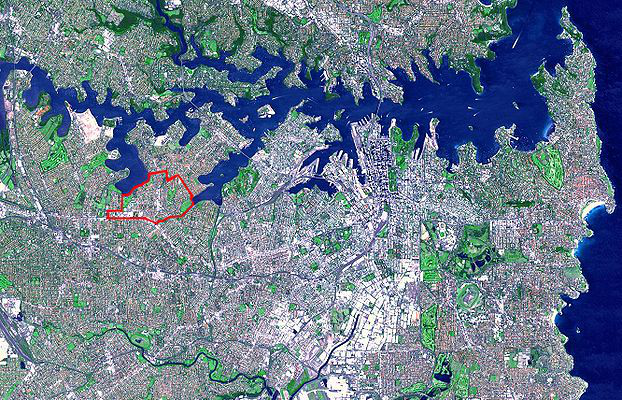

In [14]:
img = np.array(pil_img)
print(img.size)
D(img[:400])

# Sliding Window Algorithm

In [15]:
def _one_dimensional_sliding_window(
    dimension: int,
    window_size: int,
    overlap_ratio: float,
    warn_letfover: bool = True,
    allows_out_of_bound: bool = False,
    share_out_of_bound_on_both_end: bool = True,
):
    assert (
        0 <= overlap_ratio < 1
    ), f"ratio must be in-between 0 and 1, but was {overlap_ratio}"
    assert (
        window_size <= dimension
    ), f"window size must be <= image shape, but was {window_size} ({dimension})"

    increment = math.ceil((1 - overlap_ratio) * window_size)
    assert increment > 0

    # compute how many tile is needed to fully cover the original dimension
    # we first subtract `dimension` by the `tile` size, as it provides us the necessary
    # start point that we need to reach, in order to cover the full dimension within the
    # next tile.
    # We divide by `increment`, as that's how far we can move per tile. If there is no
    # overlapping, then `increment`=`window_size`, and the whole expression revert back
    # to a simple length division. However, since our increment amount is different than
    # the length that each tile covers, the following expresson always computes the
    # minimum necessary tile need to cover the whole dimension with the specified
    # overlapping amount.
    tile_needed = ((dimension - window_size) / increment) + 1.0
    # for example, if `tile_needed`=3.45, it means it needs at least 4 full tiles to
    # fully cover the whole dimension. However, if `tile_needed` is an integer, then
    # there are no left over.
    starting_at = 0
    end_padding = 0
    if not tile_needed.is_integer():
        if allows_out_of_bound:
            # leftover is some value less than 1 full window size
            leftover = dimension - (math.floor(tile_needed) * increment)
            # over_size is the amount that we are over, if we were to add 1 more tile.
            over_size = window_size - leftover

            if share_out_of_bound_on_both_end:
                # semi-equally divide the oversize on both-ends.
                # this slightly bais the starts to have more out-of-bound if `over_size` is odd.
                end_padding = over_size // 2
                starting_at = end_padding - over_size  # this should be negative
            else:
                # just left the out-of-bound at the end.
                end_padding = leftover
            tile_needed = math.ceil(tile_needed)
        else:
            # round down.
            tile_needed = math.floor(tile_needed)
            if warn_letfover:
                warnings.warn(
                    f"Sliding window {window_size} with overlapping ratio {overlap_ratio} "
                    f"does not fully covers dimension {dimension}: leftover={(tile_needed - int(tile_needed)) * window_size}"
                )

    padding_needed = abs(starting_at), end_padding

    tile_needed = int(tile_needed)

    def _gen():
        for i in range(tile_needed):
            start = starting_at + i * increment
            yield start, start + window_size

    return padding_needed, list(_gen())


def sliding_window(
    dimensions,
    window_sizes,
    overlap_ratios,
    allows_out_of_bound: bool = False,
    **kwarg,
):
    assert (
        len(dimensions) == len(window_sizes) == len(overlap_ratios)
    ), "incorrect num dim"

    padding_needed, windows = zip(
        *tuple(
            _one_dimensional_sliding_window(
                dimension=dimensions[i],
                window_size=window_sizes[i],
                overlap_ratio=overlap_ratios[i],
                allows_out_of_bound=allows_out_of_bound,
                **kwarg,
            )
            for i in range(len(dimensions))
        )
    )

    return padding_needed, itertools.product(*windows)


print(_one_dimensional_sliding_window(100, 20, 0.0))
print(_one_dimensional_sliding_window(100, 21, 0.0, allows_out_of_bound=True))
print(_one_dimensional_sliding_window(100, 21, 0.8, allows_out_of_bound=True))

# ic((_one_dimensional_sliding_window(img.shape[0], 300, 0.0, allows_out_of_bound=True)))

((0, 0), [(0, 20), (20, 40), (40, 60), (60, 80), (80, 100)])
((3, 2), [(-3, 18), (18, 39), (39, 60), (60, 81), (81, 102)])
((1, 0), [(-1, 20), (4, 25), (9, 30), (14, 35), (19, 40), (24, 45), (29, 50), (34, 55), (39, 60), (44, 65), (49, 70), (54, 75), (59, 80), (64, 85), (69, 90), (74, 95), (79, 100)])


# Helper to manipulate Image

In [16]:
def add_margin(pil_img, top, right, bottom, left, color):
    width, height = pil_img.size
    new_width = width + right + left
    new_height = height + top + bottom
    result = Image.new(pil_img.mode, (new_width, new_height), color)
    result.paste(pil_img, (left, top))
    return result

# Image Splitting Algorithm

In [17]:
from typing import Tuple


def split_into_grid(
    image,
    target_size: Tuple[int, int],
    overlap_ratios: Tuple[float, float] = (0.0, 0.0),
    expand_outside_boundary: bool = True,
):
    img_shape = image.shape[:2]

    images = []
    dim_slices = []

    paddings_needed, sliding_windows = sliding_window(
        img_shape,
        target_size,
        overlap_ratios=overlap_ratios,
        allows_out_of_bound=expand_outside_boundary,
    )

    # add padding
    image = np.array(
        add_margin(
            pil_img,
            top=paddings_needed[0][0],
            bottom=paddings_needed[0][1],
            left=paddings_needed[1][0],
            right=paddings_needed[1][1],
            color=(0, 0, 0),
        )
    )
    y_start_offset = paddings_needed[0][0]
    x_start_offset = paddings_needed[1][0]

    for y_slice, x_slice in sliding_windows:
        # shfit the index by the startng offset.
        padded_y_slice = (
            y_start_offset + y_slice[0],
            y_start_offset + y_slice[1],
        )
        padded_x_slice = (
            x_start_offset + x_slice[0],
            x_start_offset + x_slice[1],
        )

        images.append(
            image[
                padded_y_slice[0] : padded_y_slice[1],
                padded_x_slice[0] : padded_x_slice[1],
                ...,
            ]
        )

        dim_slices.append((y_slice, x_slice))

    return images, dim_slices

# Plotting Utils

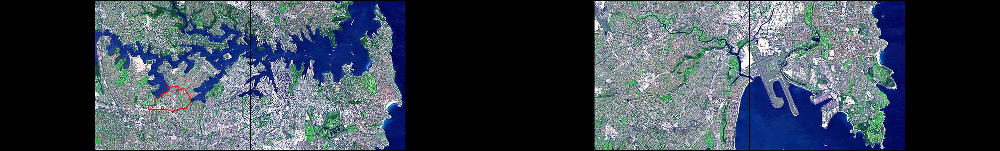

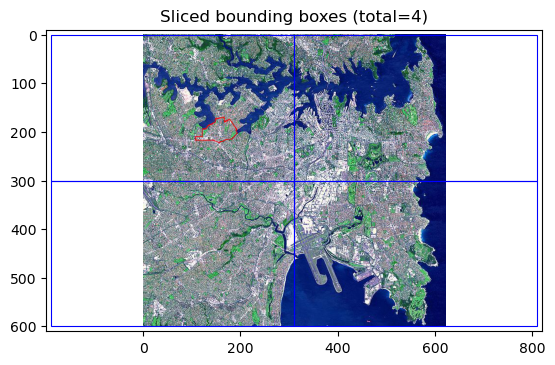

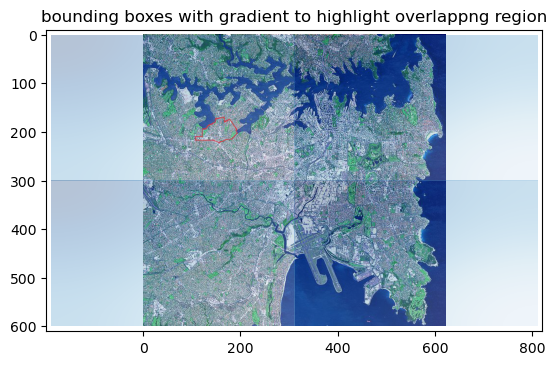

In [18]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

import torch  # only used to plot baatch of images


def gradient_image(ax, direction=0.5, cmap_range=(0, 1), **kwargs):
    """
    Draw a gradient image based on a colormap.
    """
    phi = direction * np.pi / 2
    v = np.array([np.cos(phi), np.sin(phi)])
    X = np.array([[v @ [1, 0], v @ [1, 1]], [v @ [0, 0], v @ [0, 1]]])
    a, b = cmap_range
    X = a + (b - a) / X.max() * X
    im = ax.imshow(X, interpolation="bicubic", clim=(0, 1), aspect="auto", **kwargs)
    return im


class Plottor:
    def __init__(self, img):
        self.img = img
        self.margin = 10
        self._xmin = 0
        self._xmax = img.shape[1]
        self._ymin = 0
        self._ymax = img.shape[0]

    def update_slice(self, x_slice, y_slice):
        self._xmin = min(self._xmin, x_slice[0])
        self._xmax = max(self._xmax, x_slice[1])
        self._ymin = min(self._ymin, y_slice[0])
        self._ymax = max(self._ymax, y_slice[1])

    def __enter__(self):
        plt.imshow(self.img, origin="upper")
        return self, plt.gca()

    def __exit__(self, *_):
        plt.gca().set(
            xlim=(self._xmin - self.margin, self._xmax + self.margin),
            ylim=(self._ymax + self.margin, self._ymin - self.margin),
        )
        plt.gca().set_aspect("equal", "box")
        plt.show()


def slice_and_plot(*args, **kwargs):
    images, dim_slices = split_into_grid(*args, **kwargs)

    D(torch.stack([torch.LongTensor(im) for im in images]))

    with Plottor(img) as (plotter, ax):
        for y_slice, x_slice in dim_slices:
            # Create a Rectangle patch
            rect = patches.Rectangle(
                [x_slice[0], y_slice[0]],
                x_slice[1] - x_slice[0],
                y_slice[1] - y_slice[0],
                linewidth=0.8,
                edgecolor="b",
                facecolor="none",
            )
            plt.gca().add_patch(rect)
            plotter.update_slice(x_slice, y_slice)
        ax.set_title(f"Sliced bounding boxes (total={len(dim_slices)})")

    with Plottor(img) as (plotter, ax):
        for y_slice, x_slice in dim_slices:
            gradient_image(
                ax,
                extent=(*x_slice, *y_slice),
                cmap=plt.cm.Blues_r,
                cmap_range=(0, 0.8),
                alpha=0.3,
            )
            plotter.update_slice(x_slice, y_slice)
        ax.set_title(f"bounding boxes with gradient to highlight overlappng region")


slice_and_plot(
    img,
    target_size=[300, 500],
)

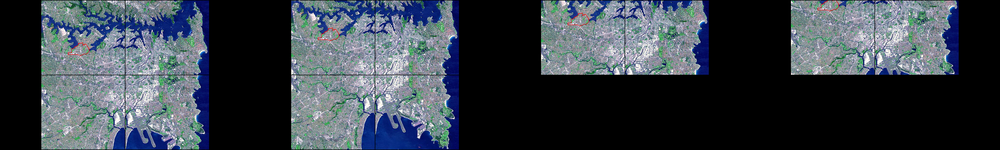

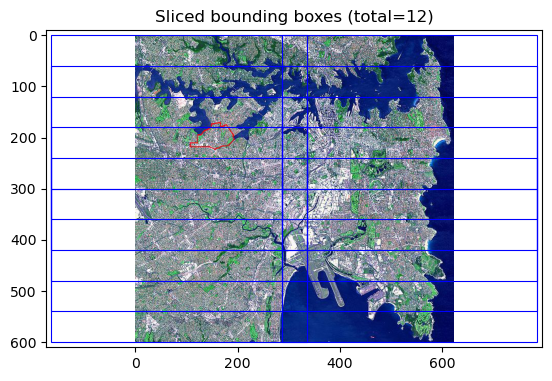

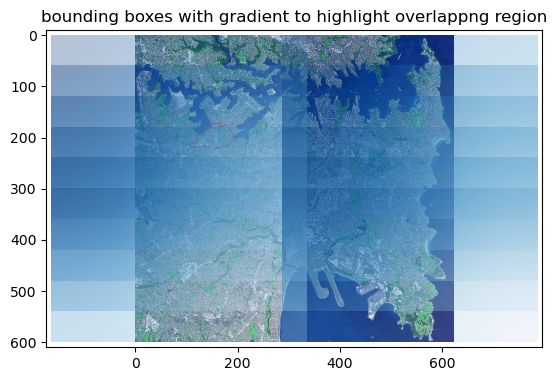

In [19]:
slice_and_plot(
    img,
    target_size=[300, 500],
    overlap_ratios=[0.8, 0.1],
)

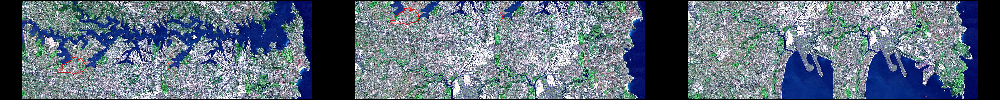

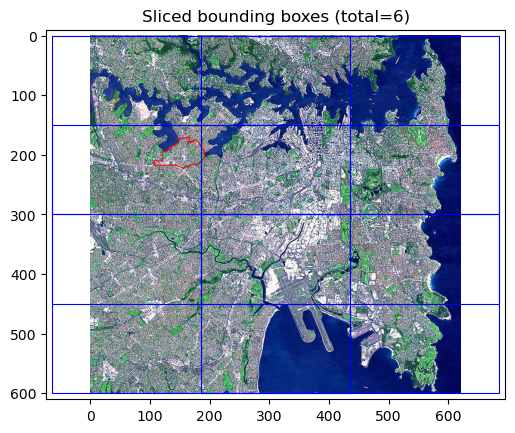

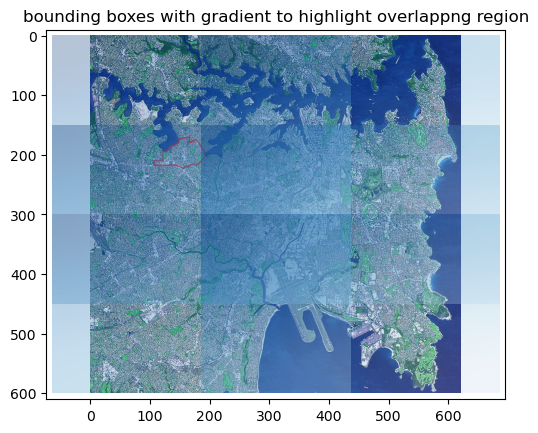

In [20]:
slice_and_plot(
    img,
    target_size=[300, 500],
    overlap_ratios=[0.5, 0.5],
)

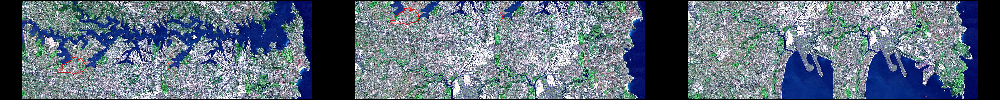

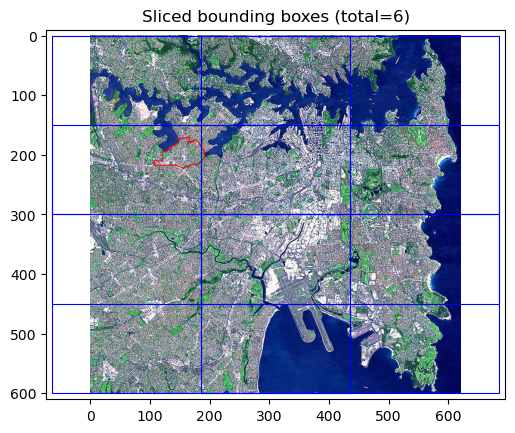

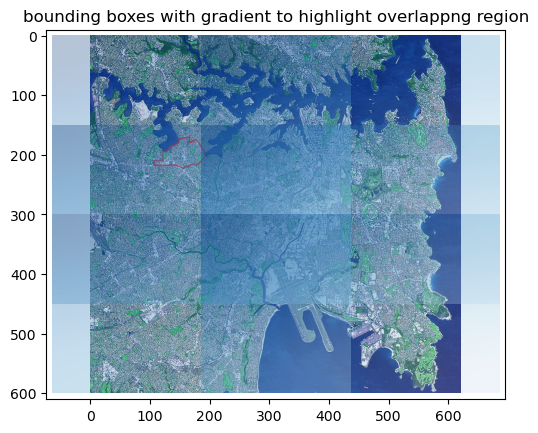

In [21]:
slice_and_plot(
    img,
    target_size=[300, 500],
    overlap_ratios=[0.5, 0.5],
)